# <center>Data Mining para Ciencia y Tecnología: Trabajo Práctico Nº1</center>

<center>Federico Moreno - Bianca Picchetti</center>

In [41]:
# Para visuzalización en notebook
%matplotlib inline
import matplotlib.pyplot as plt
import matplotlib as mpl
mpl.rcParams['figure.figsize'] = (18,12)
mpl.rcParams['font.size'] = 12
from IPython.display import Audio, Markdown, Image
import seaborn as sns

# Números y Datos
import numpy as np
import pandas as pd

# Archivos
#import urllib.request
import glob

# Machine learning
from sklearn.preprocessing import StandardScaler
#from sklearn.cluster import KMeans, DBSCAN
#from sklearn.metrics import adjusted_rand_score

## Introducción

Utilizando la API de Spotify se descargó la información de 2206 pistas de audio. Cada registro tiene variables de features de alto (audio_features), bajo nivel (audio_analysis) y de metadata, las cuales en su mayoría no van a ser útiles para el análisis.

### Carga de datasets *metadata* y *audio_feature*

In [2]:
metadata = pd.read_csv('data/metadata.csv', index_col='id')
audio_f = pd.read_csv('data/audio_features.csv', index_col='id')

### Carga archivos *audio_analysis*

#### Timbre

In [3]:
# Como DataFrame
aa_timbre1 = glob.glob('data/audio_analysis/timbre/*')

# Agrega una columna con el nombre del archivo
filename = (pd.read_csv(f).assign(filename=f.split(".")[0].split("\\")[1]) for f in aa_timbre1)

# Concatena todos los dataframes
timbre1 = pd.concat(filename, ignore_index=True, sort=False)

timbre1.head()

,start,0,1,2,3,4,5,6,7,8,9,10,11,filename
0,0.00000,0.000,171.130,9.469,-28.480,57.491,-50.067,14.833,5.359,-27.228,0.973,-10.640,-7.228,00At7PWydsvg7g5xgaYan9
1,0.24381,37.641,-77.643,-30.613,137.462,36.960,-51.024,-18.745,-28.822,-7.170,-1.994,-15.695,9.411,00At7PWydsvg7g5xgaYan9
2,0.41873,38.171,-17.741,-22.798,149.223,31.833,-53.446,-36.485,-39.479,-25.795,-1.903,-21.908,15.934,00At7PWydsvg7g5xgaYan9
3,0.59202,38.355,38.741,9.159,164.086,33.475,-83.620,-51.036,-23.505,-19.636,8.674,-18.950,6.718,00At7PWydsvg7g5xgaYan9
4,0.76553,40.292,38.220,-50.706,130.054,-4.597,-82.764,-32.596,-48.432,-21.086,20.443,-27.538,25.327,00At7PWydsvg7g5xgaYan9


#### Pitch

In [4]:
# Como DataFrame
aa_pitch1 = glob.glob('data/audio_analysis/timbre/*')

# Agrega una columna con el nombre del archivo
filenamep = (pd.read_csv(f).assign(filename=f.split(".")[0].split("\\")[1]) for f in aa_pitch1)

# Concatena todos los dataframes
pitch1 = pd.concat(filenamep, ignore_index=True, sort=False)

pitch1.head()

,start,0,1,2,3,4,5,6,7,8,9,10,11,filename
0,0.00000,0.000,171.130,9.469,-28.480,57.491,-50.067,14.833,5.359,-27.228,0.973,-10.640,-7.228,00At7PWydsvg7g5xgaYan9
1,0.24381,37.641,-77.643,-30.613,137.462,36.960,-51.024,-18.745,-28.822,-7.170,-1.994,-15.695,9.411,00At7PWydsvg7g5xgaYan9
2,0.41873,38.171,-17.741,-22.798,149.223,31.833,-53.446,-36.485,-39.479,-25.795,-1.903,-21.908,15.934,00At7PWydsvg7g5xgaYan9
3,0.59202,38.355,38.741,9.159,164.086,33.475,-83.620,-51.036,-23.505,-19.636,8.674,-18.950,6.718,00At7PWydsvg7g5xgaYan9
4,0.76553,40.292,38.220,-50.706,130.054,-4.597,-82.764,-32.596,-48.432,-21.086,20.443,-27.538,25.327,00At7PWydsvg7g5xgaYan9


## Dataset *metadata*

De los datos de metadata, separar las etiquetas que se podrán utilizar para la validación externa (Artista, Álbum, Año, Género), de los campos que no se utilizarán en este TP.

In [5]:
metadata.info()

<class 'pandas.core.frame.DataFrame'>
Index: 2206 entries, 5i2sgqnzaxYpvXmGAB592h to 4CifeS2HwRff5L5acCOEKr
Data columns (total 17 columns):
album                2206 non-null object
artists              2203 non-null object
available_markets    2206 non-null object
disc_number          2206 non-null int64
duration_ms          2206 non-null int64
explicit             2206 non-null bool
external_ids         2206 non-null object
external_urls        2206 non-null object
href                 2206 non-null object
is_local             2206 non-null bool
name                 2203 non-null object
popularity           2206 non-null int64
preview_url          985 non-null object
track_number         2206 non-null int64
type                 2206 non-null object
uri                  2206 non-null object
genre                2206 non-null object
dtypes: bool(2), int64(4), object(11)
memory usage: 280.1+ KB


In [8]:
metadata.head()

,album,artists,available_markets,disc_number,duration_ms,explicit,external_ids,external_urls,href,is_local,name,popularity,preview_url,track_number,type,uri,genre
id,,,,,,,,,,,,,,,,,
5i2sgqnzaxYpvXmGAB592h,"{'album_type': 'ALBUM', 'artists': [{'external...",Stan Getz,[],1,253933,False,{'isrc': 'USPR36307074'},{'spotify': 'https://open.spotify.com/track/5i...,https://api.spotify.com/v1/tracks/5i2sgqnzaxYp...,False,Corcovado - Quiet Nights Of Quiet Stars,12,NaN,5,track,spotify:track:5i2sgqnzaxYpvXmGAB592h,jazz
4mGzm5ahHxMX5IhVWbU7cl,"{'album_type': 'ALBUM', 'artists': [{'external...",Nina Simone,[],1,249823,False,{'isrc': 'QMSGD1370010'},{'spotify': 'https://open.spotify.com/track/4m...,https://api.spotify.com/v1/tracks/4mGzm5ahHxMX...,False,I Loves You Porgy,6,NaN,10,track,spotify:track:4mGzm5ahHxMX5IhVWbU7cl,jazz
4DEn3hZzSs9MFwFNDla5Y5,"{'album_type': 'ALBUM', 'artists': [{'external...",Chick Corea,"['AD', 'AE', 'AR', 'AT', 'BE', 'BO', 'BR', 'CA...",1,185826,False,{'isrc': 'USC4R0303698'},{'spotify': 'https://open.spotify.com/track/4D...,https://api.spotify.com/v1/tracks/4DEn3hZzSs9M...,False,Swedish Landscape - Live,15,NaN,11,track,spotify:track:4DEn3hZzSs9MFwFNDla5Y5,jazz
5P6vo51dtkBYWXswH1twvK,"{'album_type': 'ALBUM', 'artists': [{'external...",Snarky Puppy,[],1,645893,False,{'isrc': 'US8JA1411008'},{'spotify': 'https://open.spotify.com/track/5P...,https://api.spotify.com/v1/tracks/5P6vo51dtkBY...,False,Lingus,0,NaN,8,track,spotify:track:5P6vo51dtkBYWXswH1twvK,jazz
29TZQMVLv25CBm3bYn2EIQ,"{'album_type': 'ALBUM', 'artists': [{'external...",Sam Rivers,"['AD', 'AE', 'AR', 'AT', 'AU', 'BE', 'BG', 'BH...",1,326400,False,{'isrc': 'USBN20100519'},{'spotify': 'https://open.spotify.com/track/29...,https://api.spotify.com/v1/tracks/29TZQMVLv25C...,False,Kinda Dukish,12,NaN,2,track,spotify:track:29TZQMVLv25CBm3bYn2EIQ,jazz


*Dado que aún no se conoce el objetivo del trabajo práctico, se seleccionan provisoriamente las columnas **album**, **artists**, **name** y **genre**. Esta elección será modificads en base a las consignas.*

In [10]:
metadata_sub = metadata.loc[:,["album","artists","name","genre"]]
metadata_sub.info()

<class 'pandas.core.frame.DataFrame'>
Index: 2206 entries, 5i2sgqnzaxYpvXmGAB592h to 4CifeS2HwRff5L5acCOEKr
Data columns (total 4 columns):
album      2206 non-null object
artists    2203 non-null object
name       2203 non-null object
genre      2206 non-null object
dtypes: object(4)
memory usage: 166.2+ KB


## Dataset *audio_features*

El dataset audio_features contiene 9 atributos globales de alto nivel para cada pista de audio. Ejemplos para realizar los pasos pueden encontrarse en: https://github.com/pabloriera/dmcyt_tp1/blob/master/Introduccion.ipynb.    

In [11]:
audio_f.info()

<class 'pandas.core.frame.DataFrame'>
Index: 2206 entries, 5i2sgqnzaxYpvXmGAB592h to 4CifeS2HwRff5L5acCOEKr
Data columns (total 17 columns):
acousticness        2206 non-null float64
analysis_url        2206 non-null object
danceability        2206 non-null float64
duration_ms         2206 non-null int64
energy              2206 non-null float64
instrumentalness    2206 non-null float64
key                 2206 non-null int64
liveness            2206 non-null float64
loudness            2206 non-null float64
mode                2206 non-null int64
speechiness         2206 non-null float64
tempo               2206 non-null float64
time_signature      2206 non-null int64
track_href          2206 non-null object
type                2206 non-null object
uri                 2206 non-null object
valence             2206 non-null float64
dtypes: float64(9), int64(4), object(4)
memory usage: 310.2+ KB


In [12]:
audio_f.head()

,acousticness,analysis_url,danceability,duration_ms,energy,instrumentalness,key,liveness,loudness,mode,speechiness,tempo,time_signature,track_href,type,uri,valence
id,,,,,,,,,,,,,,,,,
5i2sgqnzaxYpvXmGAB592h,0.957,https://api.spotify.com/v1/audio-analysis/5i2s...,0.524,253933,0.1080,0.001230,0,0.139,-18.361,1,0.0493,127.982,4,https://api.spotify.com/v1/tracks/5i2sgqnzaxYp...,audio_features,spotify:track:5i2sgqnzaxYpvXmGAB592h,0.322
4mGzm5ahHxMX5IhVWbU7cl,0.953,https://api.spotify.com/v1/audio-analysis/4mGz...,0.480,249823,0.0322,0.000004,4,0.098,-23.781,1,0.0604,121.766,4,https://api.spotify.com/v1/tracks/4mGzm5ahHxMX...,audio_features,spotify:track:4mGzm5ahHxMX5IhVWbU7cl,0.172
4DEn3hZzSs9MFwFNDla5Y5,0.989,https://api.spotify.com/v1/audio-analysis/4DEn...,0.394,185827,0.1500,0.908000,5,0.342,-21.133,0,0.0353,97.738,3,https://api.spotify.com/v1/tracks/4DEn3hZzSs9M...,audio_features,spotify:track:4DEn3hZzSs9MFwFNDla5Y5,0.170
5P6vo51dtkBYWXswH1twvK,0.174,https://api.spotify.com/v1/audio-analysis/5P6v...,0.461,645894,0.7730,0.702000,9,0.692,-10.316,0,0.1470,130.109,5,https://api.spotify.com/v1/tracks/5P6vo51dtkBY...,audio_features,spotify:track:5P6vo51dtkBYWXswH1twvK,0.488
29TZQMVLv25CBm3bYn2EIQ,0.436,https://api.spotify.com/v1/audio-analysis/29TZ...,0.452,326400,0.5010,0.900000,10,0.110,-13.149,0,0.0329,111.203,4,https://api.spotify.com/v1/tracks/29TZQMVLv25C...,audio_features,spotify:track:29TZQMVLv25CBm3bYn2EIQ,0.602


**1.** Con los datos de audio_features, generar un gráfico tipo scatter matrix.

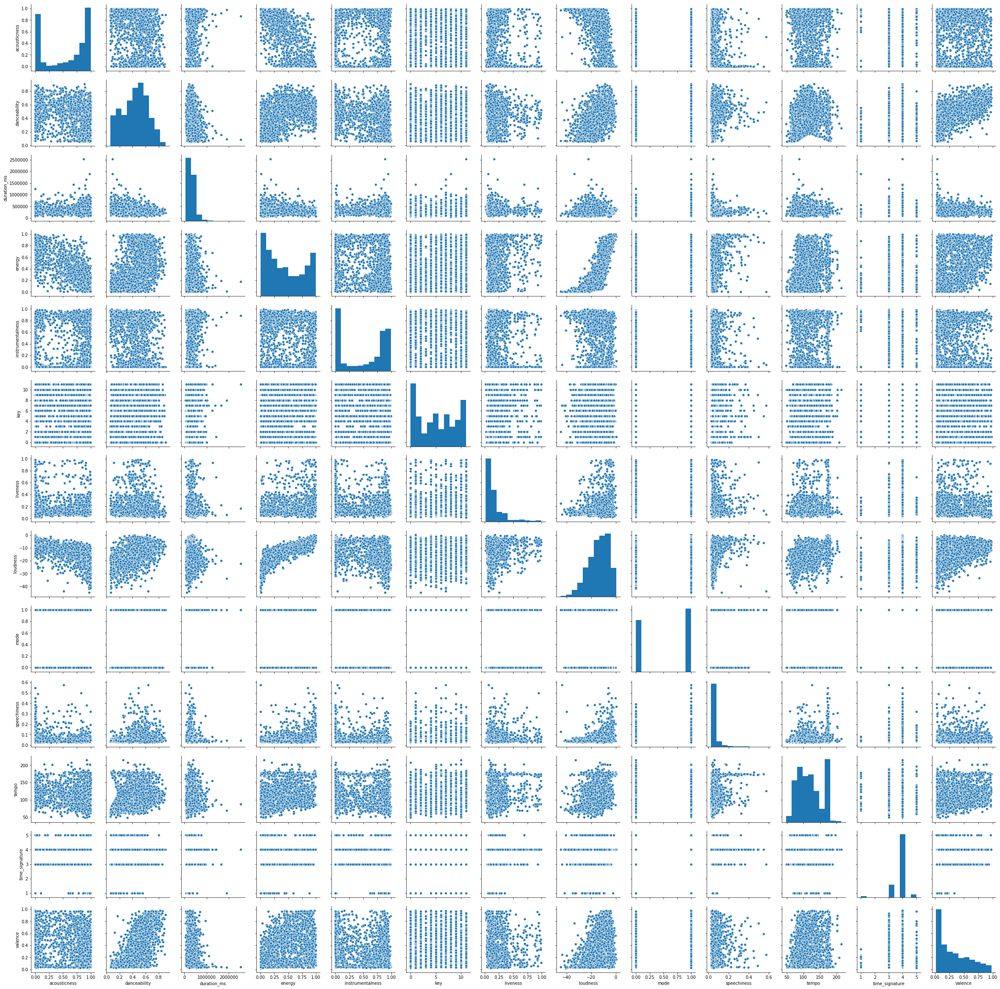

In [15]:
sns.pairplot(audio_f)

**2.** Identificar variables más o menos informativas a priori y variables que requieran, además de la estandarización, alguna corrección para asimilar la distribución a una normal.

*A priori, las variables categoricas parecerían ser las menos informativas **key**, **mode** y **time_signature**. Se quitan también las variables no numéricas. Además la variable **speechiness**, si bien es contínua, presenta poca variación en sus valores, considerandola poca informativa.*<br>
<br>
*A su vez, se realiza un gráfico de correlación para encontrar aquellas variables redundantes.*

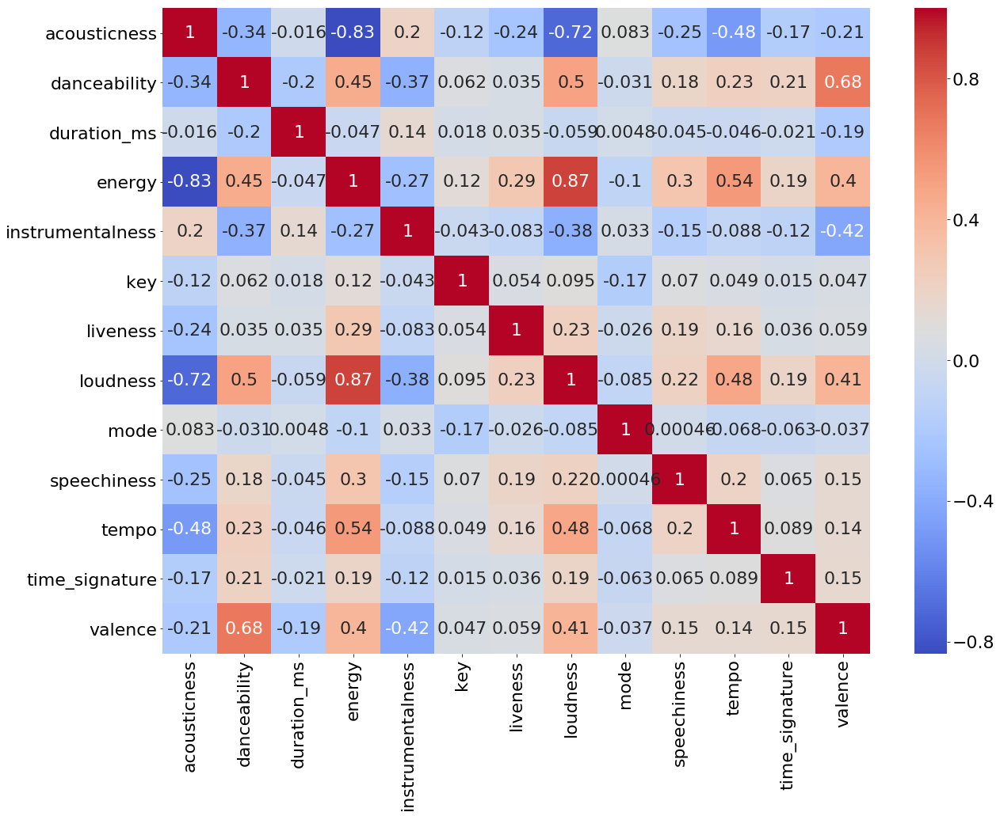

In [15]:
sns.heatmap(audio_f.corr(), cmap="coolwarm", annot=True)

*Se observa en el heatmap que las variables mayormente correlacionadas son **Energy** con **Acousticness** de manera positiva y **Energy** con **Loudness** de manera negativa. En principio, seleccionamos la variable **Energy** y descartamos **Acousticness** y **Loudness**.*

In [16]:
af_sub = audio_f.drop(["key","mode","time_signature","analysis_url","track_href","type","uri", "speechiness","loudness", "acousticness" ],axis=1)
af_sub.info()

<class 'pandas.core.frame.DataFrame'>
Index: 2206 entries, 5i2sgqnzaxYpvXmGAB592h to 4CifeS2HwRff5L5acCOEKr
Data columns (total 7 columns):
danceability        2206 non-null float64
duration_ms         2206 non-null int64
energy              2206 non-null float64
instrumentalness    2206 non-null float64
liveness            2206 non-null float64
tempo               2206 non-null float64
valence             2206 non-null float64
dtypes: float64(6), int64(1)
memory usage: 137.9+ KB


**3.** Estandarizar y volver a generar un gráfico tipo scatter matrix.

In [19]:
ss = StandardScaler()
af_norm = ss.fit_transform(af_sub) # Devuelve un array
af_sub1 = pd.DataFrame(af_norm, columns=list(af_sub.columns)) # se pasa a dataframe
af_sub1.head()

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\preprocessing\data.py:645: DataConversionWarning: Data with input dtype int64, float64 were all converted to float64 by StandardScaler.
  return self.partial_fit(X, y)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\base.py:464: DataConversionWarning: Data with input dtype int64, float64 were all converted to float64 by StandardScaler.
  return self.fit(X, **fit_params).transform(X)


,danceability,duration_ms,energy,instrumentalness,liveness,tempo,valence
0,0.449745,-0.392481,-1.029845,-1.300295,-0.231088,0.212158,-0.010722
1,0.221832,-0.417492,-1.265002,-1.303436,-0.488797,0.041103,-0.568507
2,-0.223633,-0.806927,-0.899546,1.022131,1.044891,-0.620113,-0.575944
3,0.123415,1.992726,1.033216,0.494522,3.244854,0.270690,0.606559
4,0.076797,0.048504,0.189378,1.001641,-0.413370,-0.249576,1.030476


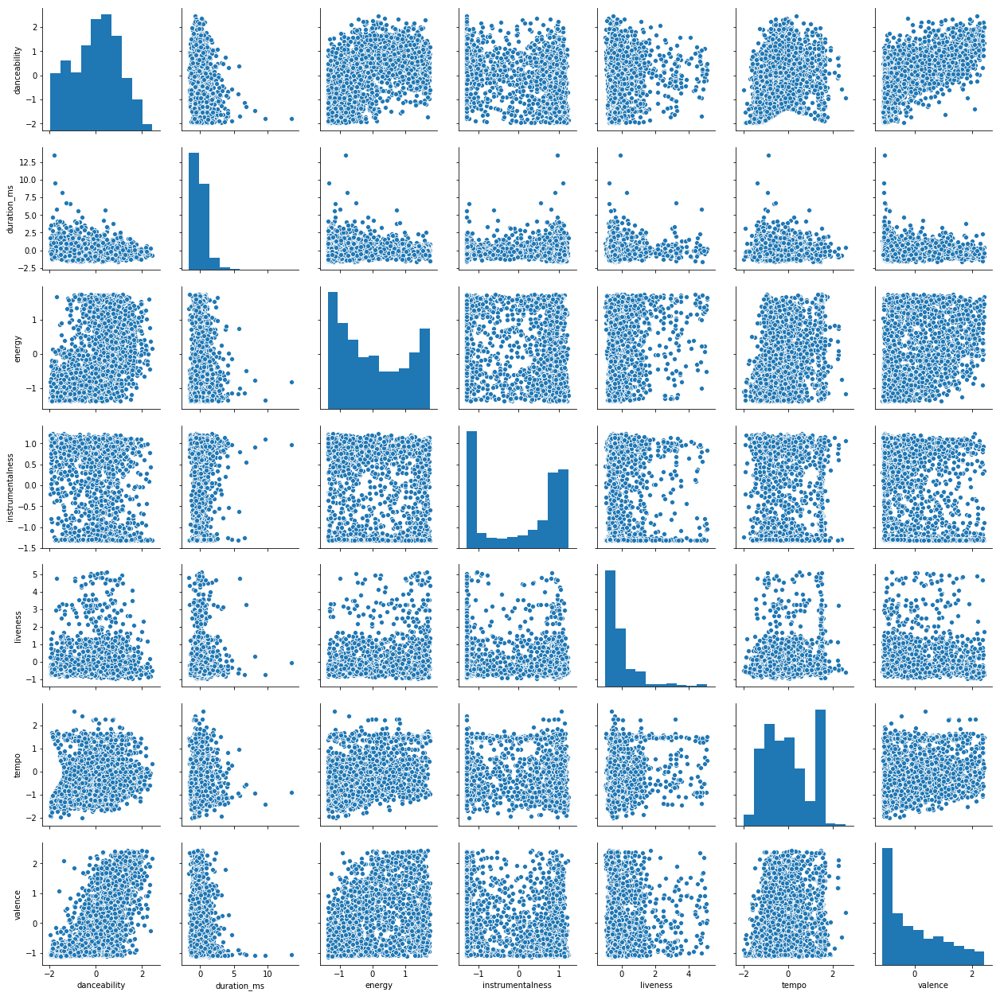

In [53]:
sns.pairplot(af_sub1)

**4.** Identificar, si es que hay, valores extremos que sea necesario descartar.

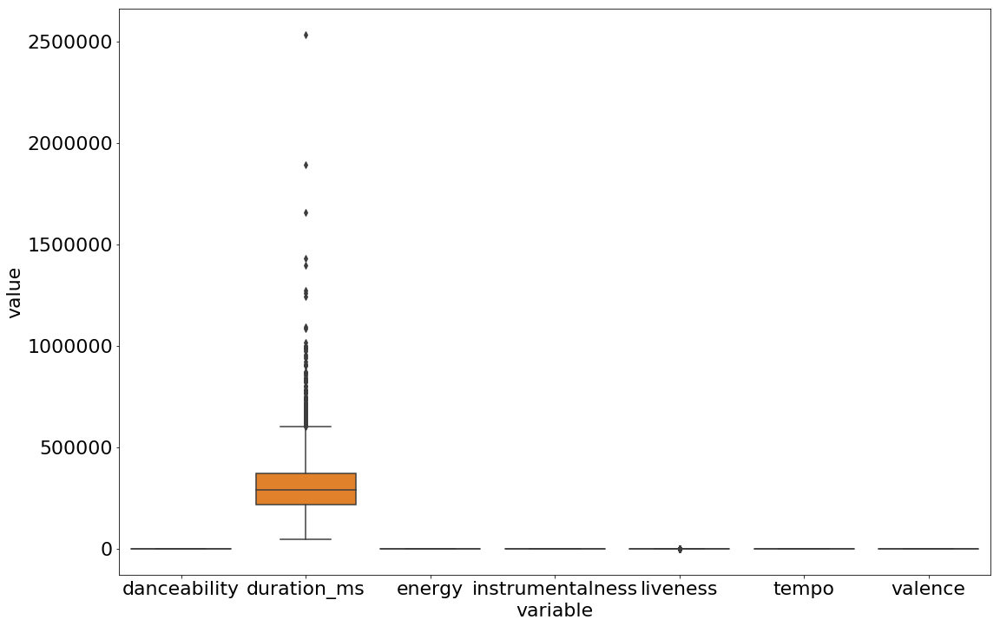

In [25]:
sns.boxplot(x="variable", y="value", data=pd.melt(af_sub))

*Si se pueden observar outliers univariados en **duration_ms**, se considera una variable descriptiva importante de un tema musical y por el momento no se descarta. Se reevaluará esta decisión al momento de hacer Clusters.*<br>
<br>
*Se repite el gráfico de boxplots quitándola, dado que no permite observar correctamente las demás variables.*

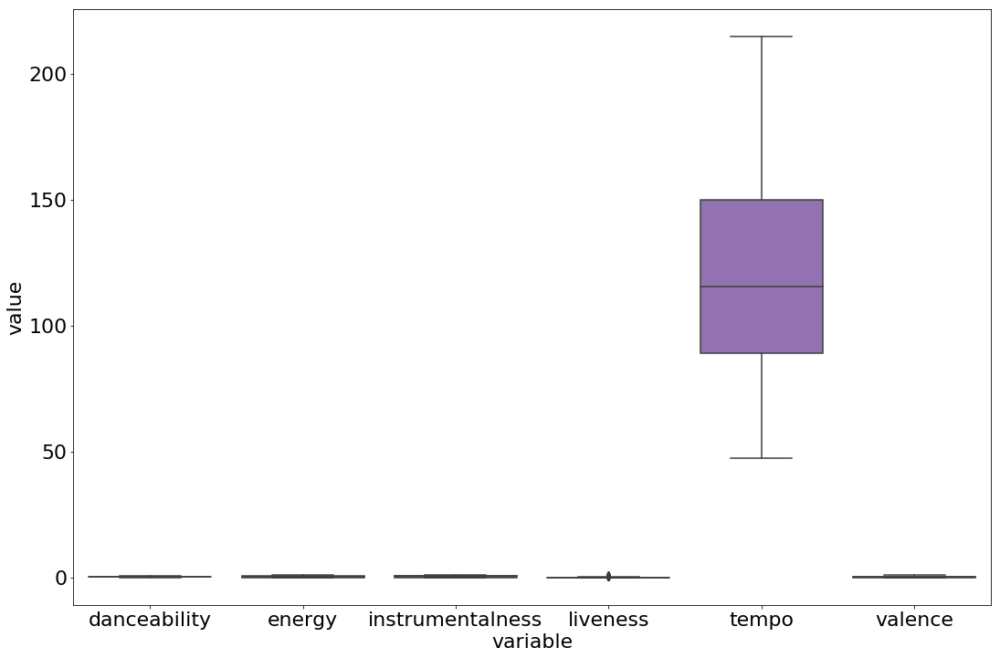

In [26]:
sns.boxplot(x="variable", y="value", data=pd.melt(af_sub.drop("duration_ms", axis=1)))

*Nuevamente, se repite el gráfico quitando la variable **tempo** para apreciar las demás.*

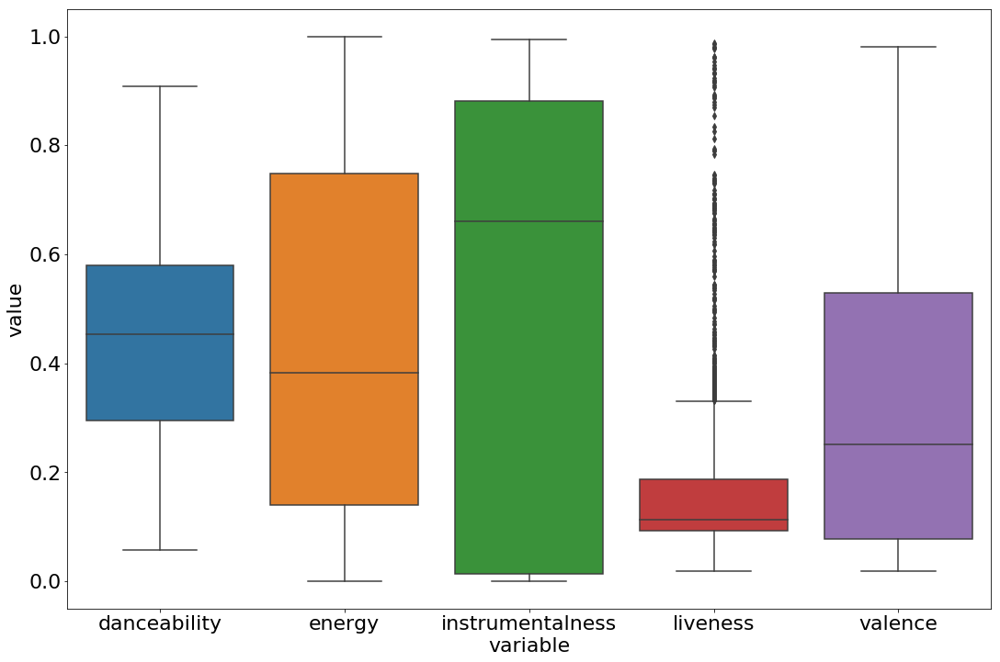

In [27]:
sns.boxplot(x="variable", y="value", data=pd.melt(af_sub.drop(["duration_ms","tempo"], axis=1)))

*Se observa gran cantidad de outliers univariados en la variable **liveness**. La misma describe la probabilidad de que un tema musical sea en vivo, detectando la presencia de audiencia. Esta presencia de "outliers" se debe a la <a href="https://developer.spotify.com/documentation/web-api/reference/tracks/get-audio-features/">distribución de sus valores</a>. Si éstos son quitados se excluirían del dataset todos los temas en vivo (o con alta probabilidad de serlo).*

## Dataset *audio_analysis*

El dataset audio_analysis contiene las variables continuas de bajo nivel, estimadas en ventanas temporales, como timbre o pitches. Al tener canciones de distintas duraciones (distinta cantidad de ventanas), estas variables se guardan por separado. Entonces, como primer paso, deberán:    

**1.** Resumir estas variables en valores por canción. Por ejemplo, tomar el promedio o el desvío estándar del timbre entre todas las ventanas, obteniendo 12 valores de timbre promedio y 12 valores de desvío estándar del timbre por canción.

In [28]:
# Timbre
timbre1 = timbre1.add_prefix('timbre_')
timbre1.head()

,timbre_start,timbre_0,timbre_1,timbre_2,timbre_3,timbre_4,timbre_5,timbre_6,timbre_7,timbre_8,timbre_9,timbre_10,timbre_11,timbre_filename
0,0.00000,0.000,171.130,9.469,-28.480,57.491,-50.067,14.833,5.359,-27.228,0.973,-10.640,-7.228,00At7PWydsvg7g5xgaYan9
1,0.24381,37.641,-77.643,-30.613,137.462,36.960,-51.024,-18.745,-28.822,-7.170,-1.994,-15.695,9.411,00At7PWydsvg7g5xgaYan9
2,0.41873,38.171,-17.741,-22.798,149.223,31.833,-53.446,-36.485,-39.479,-25.795,-1.903,-21.908,15.934,00At7PWydsvg7g5xgaYan9
3,0.59202,38.355,38.741,9.159,164.086,33.475,-83.620,-51.036,-23.505,-19.636,8.674,-18.950,6.718,00At7PWydsvg7g5xgaYan9
4,0.76553,40.292,38.220,-50.706,130.054,-4.597,-82.764,-32.596,-48.432,-21.086,20.443,-27.538,25.327,00At7PWydsvg7g5xgaYan9


In [29]:
timbre_mean = timbre1.groupby(by="timbre_filename", axis=0).mean().add_suffix("_mean")
timbre_sd = timbre1.groupby(by="timbre_filename", axis=0).std().add_suffix("_sd")

In [30]:
# Pitch
pitch1 = pitch1.add_prefix('pitch_')
pitch1.head()

,pitch_start,pitch_0,pitch_1,pitch_2,pitch_3,pitch_4,pitch_5,pitch_6,pitch_7,pitch_8,pitch_9,pitch_10,pitch_11,pitch_filename
0,0.00000,0.000,171.130,9.469,-28.480,57.491,-50.067,14.833,5.359,-27.228,0.973,-10.640,-7.228,00At7PWydsvg7g5xgaYan9
1,0.24381,37.641,-77.643,-30.613,137.462,36.960,-51.024,-18.745,-28.822,-7.170,-1.994,-15.695,9.411,00At7PWydsvg7g5xgaYan9
2,0.41873,38.171,-17.741,-22.798,149.223,31.833,-53.446,-36.485,-39.479,-25.795,-1.903,-21.908,15.934,00At7PWydsvg7g5xgaYan9
3,0.59202,38.355,38.741,9.159,164.086,33.475,-83.620,-51.036,-23.505,-19.636,8.674,-18.950,6.718,00At7PWydsvg7g5xgaYan9
4,0.76553,40.292,38.220,-50.706,130.054,-4.597,-82.764,-32.596,-48.432,-21.086,20.443,-27.538,25.327,00At7PWydsvg7g5xgaYan9


In [31]:
pitch_mean = pitch1.groupby(by="pitch_filename", axis=0).mean().add_suffix("_mean")
pitch_sd = pitch1.groupby(by="pitch_filename", axis=0).std().add_suffix("_sd")

**2.** Construir un data frame con estos valores.

*Se quitan los valores de media y desvío standard de la variable "start", dado que corresponde al tiempo de inicio de cada fragmento.*

In [32]:
aa_timbre = timbre_mean.join(timbre_sd, how="inner")
aa_timbre = aa_timbre.drop(["timbre_start_mean", "timbre_start_sd"], axis=1)

aa_pitch = pitch_mean.join(pitch_sd, how="inner")
aa_pitch = aa_pitch.drop(["pitch_start_mean", "pitch_start_sd"], axis=1)

In [34]:
aa_timbre.T

timbre_filename,00At7PWydsvg7g5xgaYan9,00BgcUYkIImsDN5rNjkR1U,00WgnFIsY1y84p7mYAJRuF,00isAURAZeKQXv6CW2vckb,00ne3qRgc0JqY6MNYfhWri,00z9Rax2KTHqKLKYnGHzNk,012Pabfp9nvUBj9NaS2tSj,01K7WtcFrsolt07wYU8zTY,01OXa5tVuCssU6j8TY7kxr,02M2OoPaKPmkCl7kidq6nK,...,7yKic0Gqsk4SGNJl4wyJAm,7yeYlzrGTzmRudvoeqa9qK,7yoQyZXnpRbh7k78dzWO00,7yqKXk9XNLMmPahxpK8pAo,7ysmJhXFQtiBQlk6EZ6sks,7yzM0pEseQUpb6BMViOPEA,7zEM8CqLmdWVaGXgBmDLzM,7zLgL7l9swkJRjm9bfZZ1c,7zg7jfg0GtxoP3bKwQC1Al,7zjWtWDCNgeXSY78nLzBQJ
timbre_0_mean,54.798519,53.810573,46.722248,34.875225,24.946929,40.689481,37.424535,37.908128,39.977622,39.008589,...,42.559994,34.267758,39.307042,37.303187,41.294980,42.233219,47.564981,44.668413,42.054639,42.539315
timbre_1_mean,92.125193,69.248870,50.900079,-66.512445,-111.683819,-3.848392,-84.159306,-126.323458,-2.141759,-4.092762,...,21.809336,-183.445620,-87.395009,-84.349082,-32.887292,-40.425094,-21.775629,-9.627828,-65.534664,-49.116107
timbre_2_mean,35.913975,-9.116627,20.885997,40.915563,17.676093,-27.113220,-41.599023,18.513360,-49.758707,19.796790,...,42.855751,19.417807,44.138319,17.184648,-12.780988,7.618606,5.494023,37.137394,-75.158203,-25.984994
timbre_3_mean,10.421557,-2.226798,15.719031,-10.102723,1.918112,-3.365690,-5.145118,-13.166445,-26.532889,8.167749,...,-10.801775,-14.515629,18.686801,-20.623283,-20.401480,-1.582882,2.533260,28.966335,-15.874988,-21.918881
timbre_4_mean,49.833244,37.537226,24.207190,35.649973,75.349067,19.196241,5.397648,11.446370,9.266454,14.911664,...,40.781738,29.730267,29.100022,0.672362,41.073419,27.031336,26.837568,30.645570,17.100977,8.127229
timbre_5_mean,-32.670363,-42.652424,-44.094831,-27.347364,-26.804925,-33.086204,-22.162466,-35.404344,-31.459059,-21.437116,...,-20.022096,-31.336857,-22.617015,-35.666023,-16.878172,-27.295503,-12.127057,-2.645046,-40.231715,-23.829179
timbre_6_mean,-2.777832,-0.684193,14.521768,-1.774950,-17.360867,16.547267,-8.369363,14.622223,15.339754,9.757984,...,-32.675310,-2.770613,7.554725,3.572004,-21.928865,9.843470,5.887839,-12.783546,-30.813024,6.848454
timbre_7_mean,2.606419,0.007623,-0.068259,0.008791,5.097928,-6.987430,-6.580743,3.522469,-2.387633,1.984570,...,-3.682512,1.773894,-4.731115,2.144033,-2.410334,-3.935947,-1.537759,0.447776,-16.787758,-5.008765
timbre_8_mean,-9.264416,-18.336879,-20.861919,6.631508,-18.741059,-9.245716,5.463874,-17.659185,-11.374124,-1.520874,...,-4.705667,-11.119086,-8.426523,1.703305,0.947388,-24.639770,-11.354840,-4.692742,14.632801,-5.990582
timbre_9_mean,6.457682,0.615241,-2.182608,-1.892666,-3.505561,-1.391172,1.068345,-8.366026,-2.683446,3.526950,...,-2.043820,-8.815507,-6.591337,0.527494,3.340344,-7.437651,1.475054,2.423485,4.980562,-1.663409


In [35]:
aa_pitch.T

pitch_filename,00At7PWydsvg7g5xgaYan9,00BgcUYkIImsDN5rNjkR1U,00WgnFIsY1y84p7mYAJRuF,00isAURAZeKQXv6CW2vckb,00ne3qRgc0JqY6MNYfhWri,00z9Rax2KTHqKLKYnGHzNk,012Pabfp9nvUBj9NaS2tSj,01K7WtcFrsolt07wYU8zTY,01OXa5tVuCssU6j8TY7kxr,02M2OoPaKPmkCl7kidq6nK,...,7yKic0Gqsk4SGNJl4wyJAm,7yeYlzrGTzmRudvoeqa9qK,7yoQyZXnpRbh7k78dzWO00,7yqKXk9XNLMmPahxpK8pAo,7ysmJhXFQtiBQlk6EZ6sks,7yzM0pEseQUpb6BMViOPEA,7zEM8CqLmdWVaGXgBmDLzM,7zLgL7l9swkJRjm9bfZZ1c,7zg7jfg0GtxoP3bKwQC1Al,7zjWtWDCNgeXSY78nLzBQJ
pitch_0_mean,54.798519,53.810573,46.722248,34.875225,24.946929,40.689481,37.424535,37.908128,39.977622,39.008589,...,42.559994,34.267758,39.307042,37.303187,41.294980,42.233219,47.564981,44.668413,42.054639,42.539315
pitch_1_mean,92.125193,69.248870,50.900079,-66.512445,-111.683819,-3.848392,-84.159306,-126.323458,-2.141759,-4.092762,...,21.809336,-183.445620,-87.395009,-84.349082,-32.887292,-40.425094,-21.775629,-9.627828,-65.534664,-49.116107
pitch_2_mean,35.913975,-9.116627,20.885997,40.915563,17.676093,-27.113220,-41.599023,18.513360,-49.758707,19.796790,...,42.855751,19.417807,44.138319,17.184648,-12.780988,7.618606,5.494023,37.137394,-75.158203,-25.984994
pitch_3_mean,10.421557,-2.226798,15.719031,-10.102723,1.918112,-3.365690,-5.145118,-13.166445,-26.532889,8.167749,...,-10.801775,-14.515629,18.686801,-20.623283,-20.401480,-1.582882,2.533260,28.966335,-15.874988,-21.918881
pitch_4_mean,49.833244,37.537226,24.207190,35.649973,75.349067,19.196241,5.397648,11.446370,9.266454,14.911664,...,40.781738,29.730267,29.100022,0.672362,41.073419,27.031336,26.837568,30.645570,17.100977,8.127229
pitch_5_mean,-32.670363,-42.652424,-44.094831,-27.347364,-26.804925,-33.086204,-22.162466,-35.404344,-31.459059,-21.437116,...,-20.022096,-31.336857,-22.617015,-35.666023,-16.878172,-27.295503,-12.127057,-2.645046,-40.231715,-23.829179
pitch_6_mean,-2.777832,-0.684193,14.521768,-1.774950,-17.360867,16.547267,-8.369363,14.622223,15.339754,9.757984,...,-32.675310,-2.770613,7.554725,3.572004,-21.928865,9.843470,5.887839,-12.783546,-30.813024,6.848454
pitch_7_mean,2.606419,0.007623,-0.068259,0.008791,5.097928,-6.987430,-6.580743,3.522469,-2.387633,1.984570,...,-3.682512,1.773894,-4.731115,2.144033,-2.410334,-3.935947,-1.537759,0.447776,-16.787758,-5.008765
pitch_8_mean,-9.264416,-18.336879,-20.861919,6.631508,-18.741059,-9.245716,5.463874,-17.659185,-11.374124,-1.520874,...,-4.705667,-11.119086,-8.426523,1.703305,0.947388,-24.639770,-11.354840,-4.692742,14.632801,-5.990582
pitch_9_mean,6.457682,0.615241,-2.182608,-1.892666,-3.505561,-1.391172,1.068345,-8.366026,-2.683446,3.526950,...,-2.043820,-8.815507,-6.591337,0.527494,3.340344,-7.437651,1.475054,2.423485,4.980562,-1.663409


**3.** Generar un gráfico tipo scatter matrix.

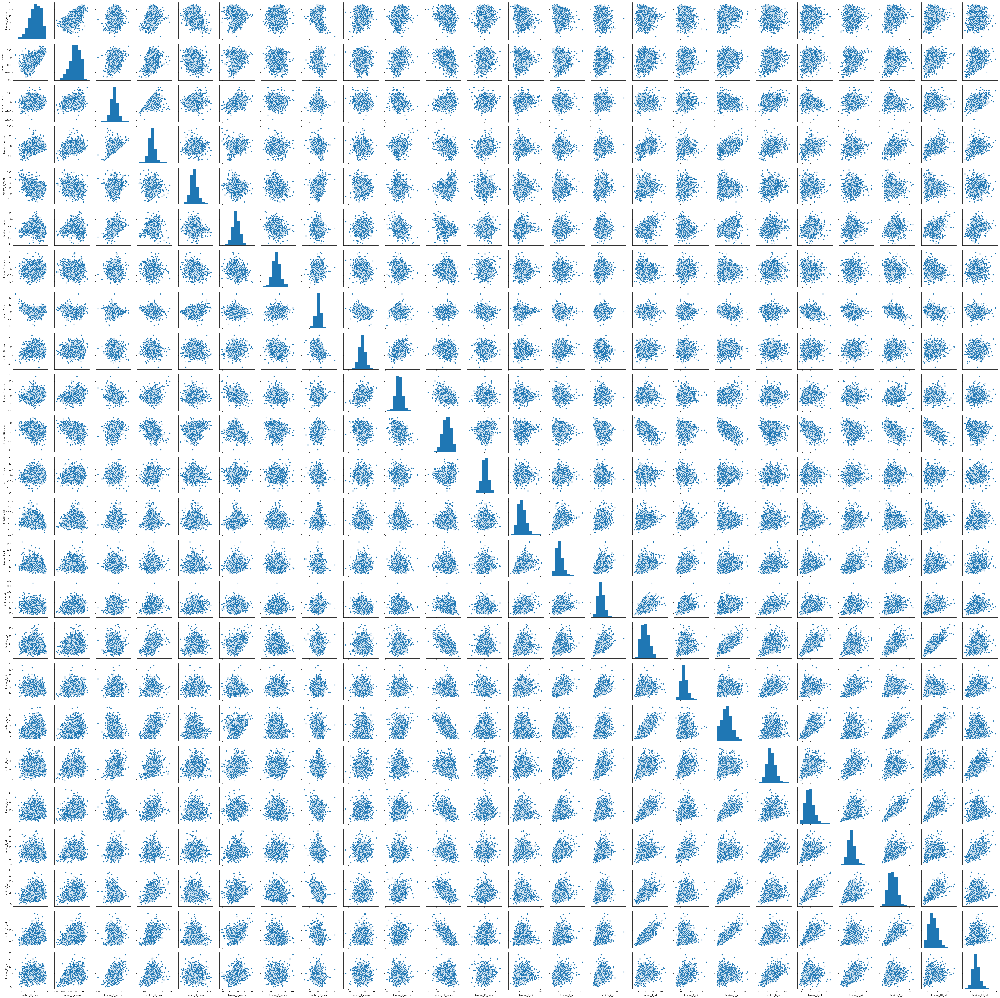

In [69]:
sns.pairplot(aa_timbre)

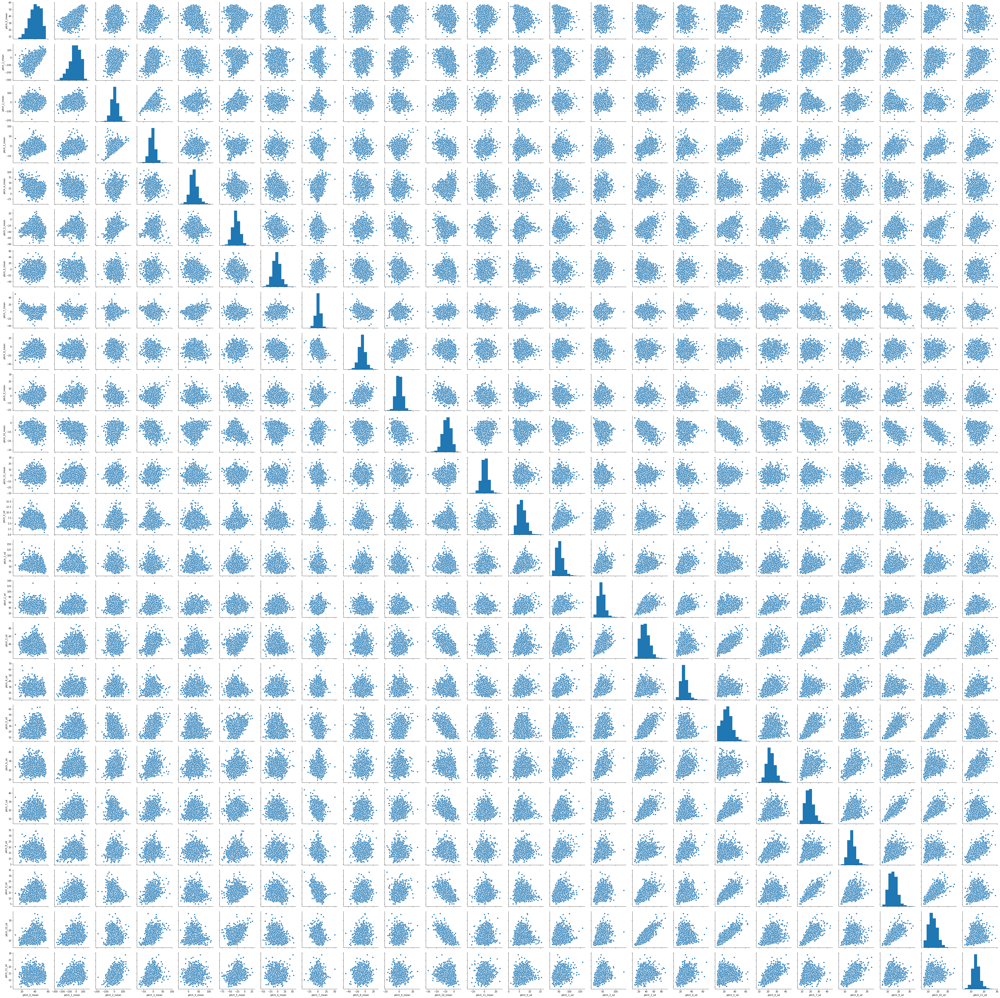

In [70]:
sns.pairplot(aa_pitch)

**4.** Identificar variables más o menos informativas a priori y variables que requieran, además de la estandarización, alguna corrección para asimilar la distribución a una normal.

*En muy pocas se puede observar una tendencia y a simple vista parecen tener una distribución normal. Si bien en algunas se observa cierta tendencia, no se considera suficiente para eliminar variables.*<br>
<br>
*Se realiza un gráfico de correlación.*<br>

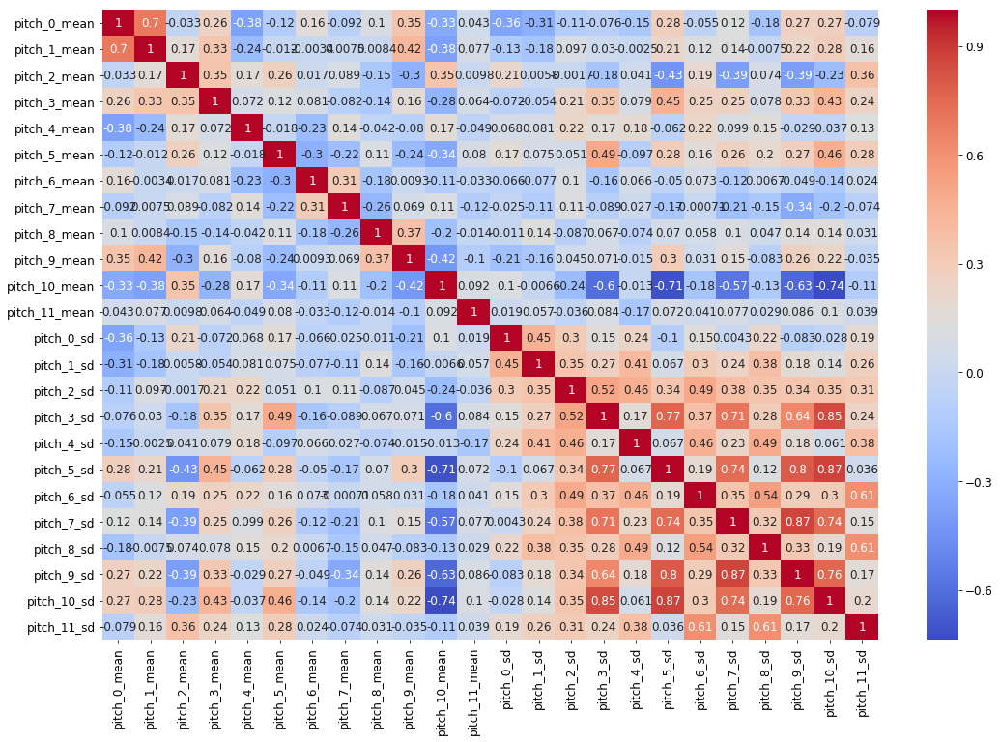

In [42]:
sns.heatmap(aa_pitch.corr(), cmap="coolwarm", annot=True)

*Se observa una zona de correlación positiva media-fuerte entre los desvíos stándard de los últimos segmentos del dataset **pitch**. A considerar: 3,7,9 y 10.*

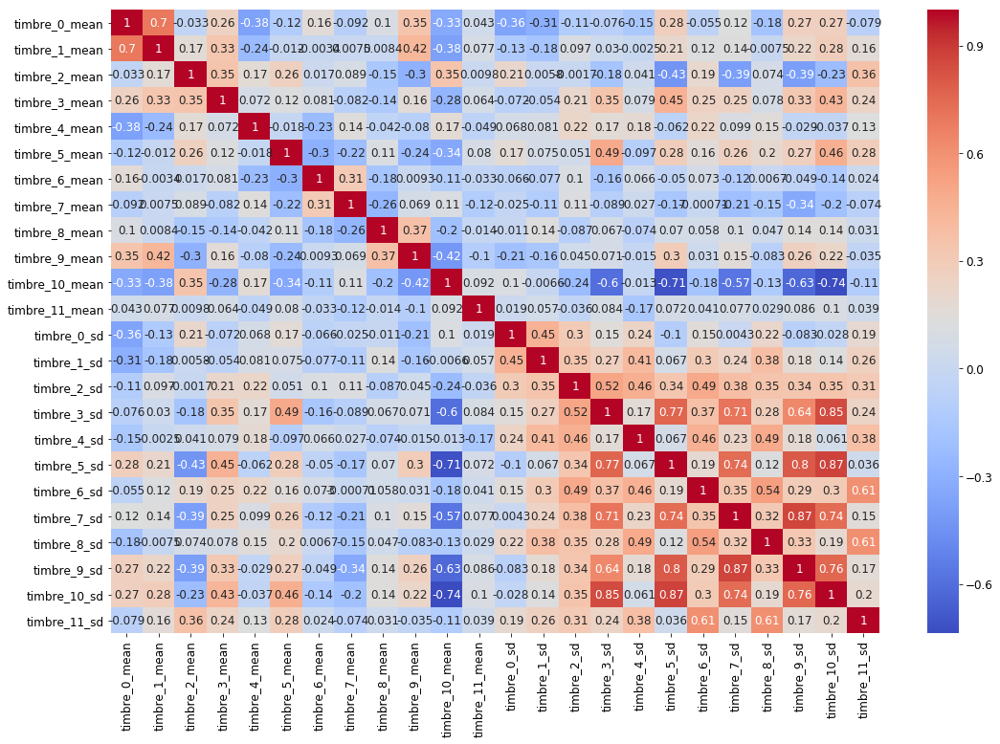

In [43]:
sns.heatmap(aa_timbre.corr(), cmap="coolwarm", annot=True)

*Se observa la misma tendencia de los desvios de pitch en los desvios de timbre.*

**5.** Estandarizar y volver a generar un gráfico tipo scatter matrix.

In [44]:
timbre_norm = ss.fit_transform(aa_timbre)
timbre_norm = pd.DataFrame(timbre_norm, columns=list(aa_timbre.columns))

In [45]:
pitch_norm = ss.fit_transform(aa_pitch)
pitch_norm = pd.DataFrame(pitch_norm, columns=list(aa_pitch.columns))

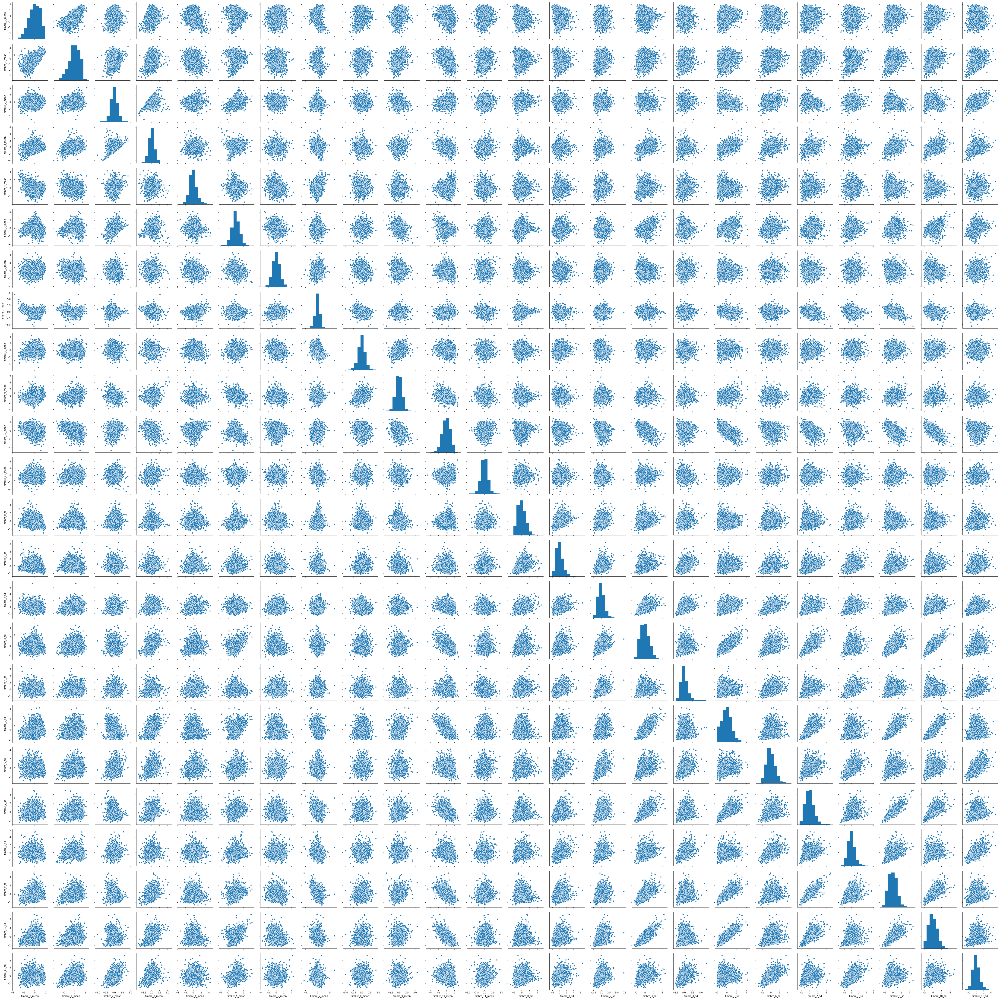

In [73]:
sns.pairplot(timbre_norm)

*No se observan cambios apreciables al standarizar las variables.*

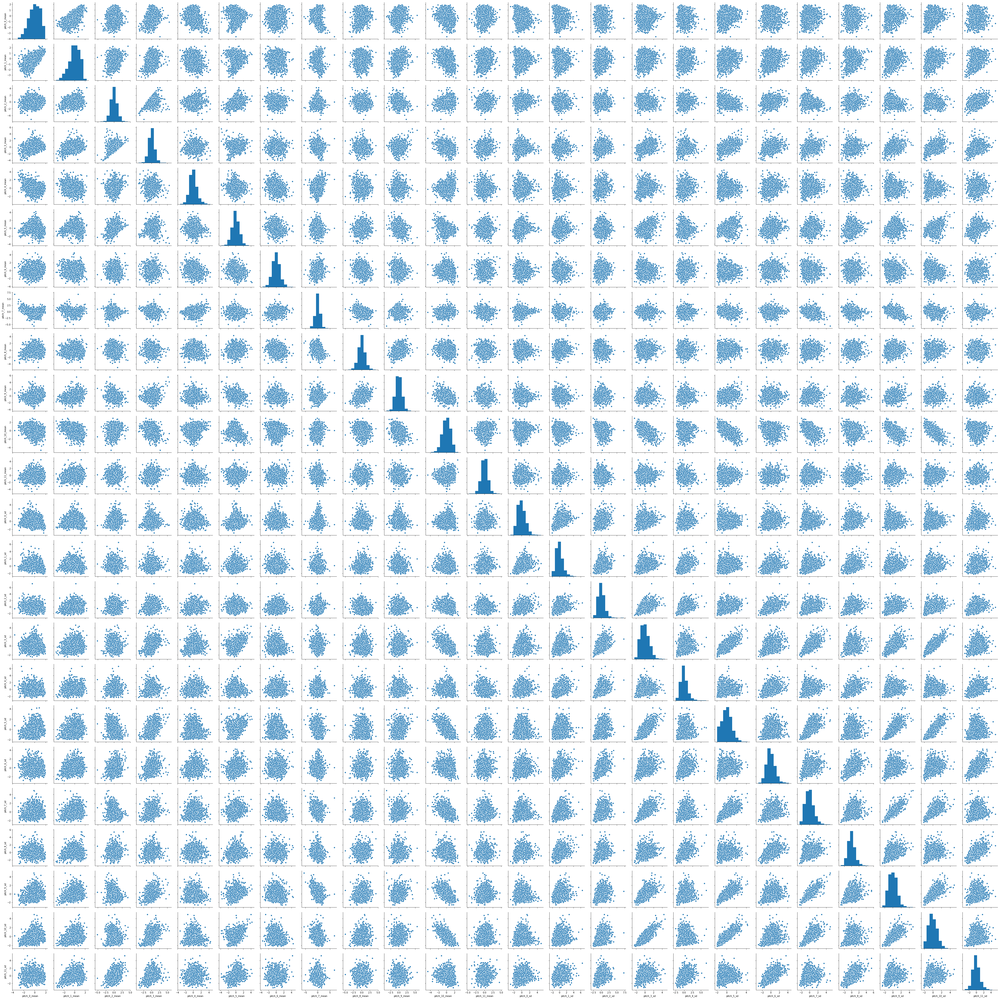

In [74]:
sns.pairplot(pitch_norm)

**6.** Identificar, si es que hay, valores extremos que sea necesario descartar.

(array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16,
        17, 18, 19, 20, 21, 22, 23]), <a list of 24 Text xticklabel objects>)

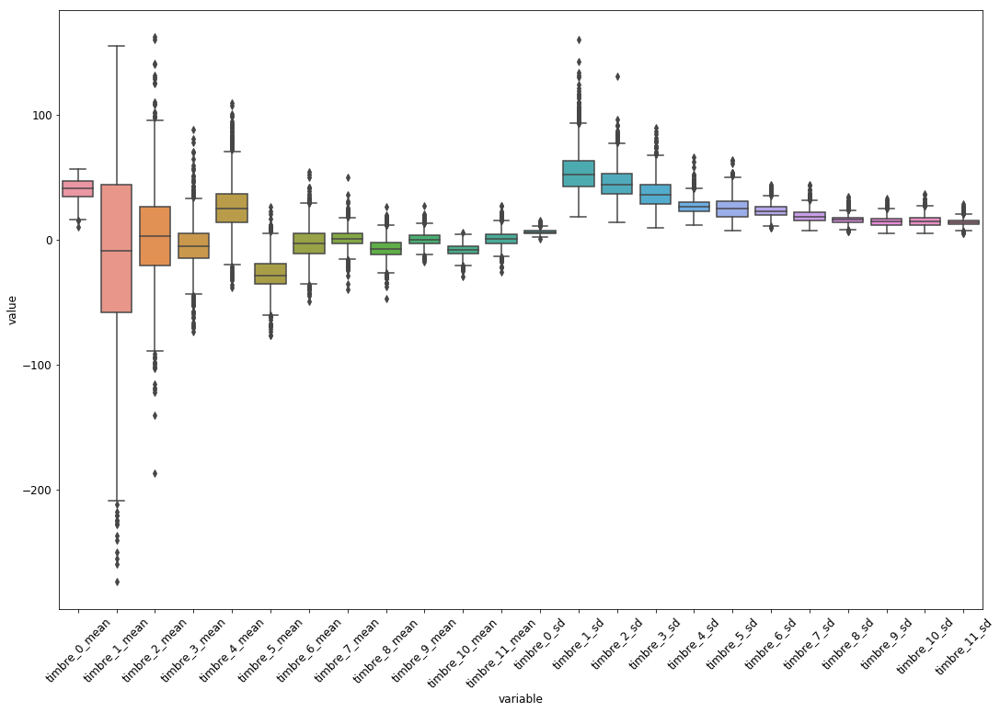

In [52]:
sns.boxplot(x="variable", y="value", data=pd.melt(aa_timbre))
plt.xticks(rotation=45)

(array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16,
        17, 18, 19, 20, 21, 22, 23]), <a list of 24 Text xticklabel objects>)

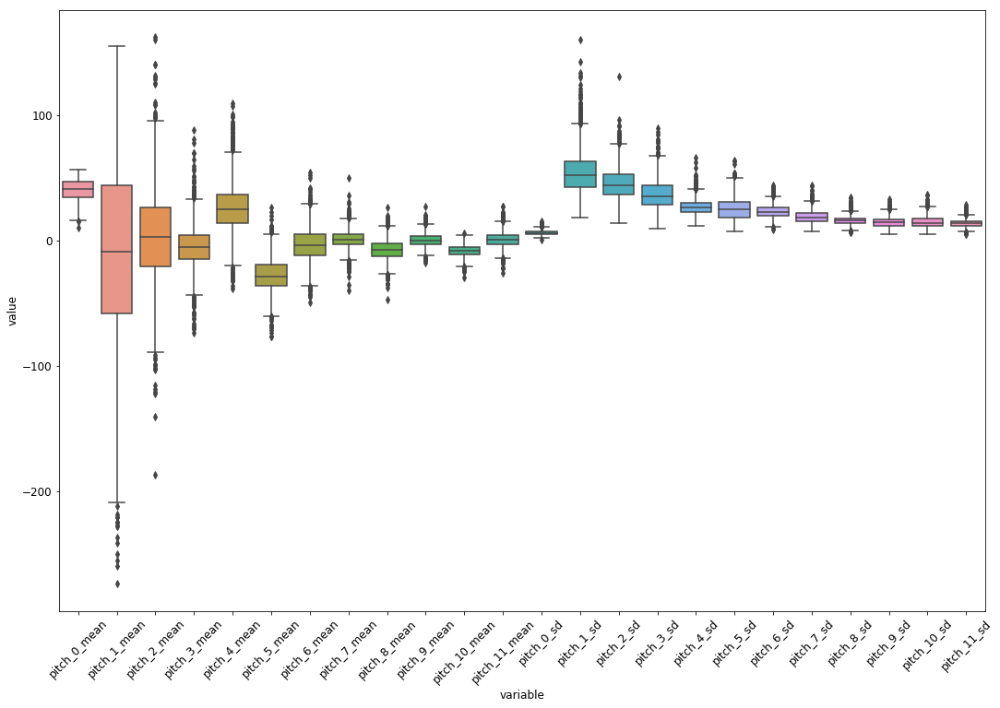

In [51]:
sns.boxplot(x="variable", y="value", data=pd.melt(aa_pitch))
plt.xticks(rotation=45)